In [57]:
import random


class Game:
    ACTION_UP = 0
    ACTION_LEFT = 1
    ACTION_DOWN = 2
    ACTION_RIGHT = 3

    ACTIONS = [ACTION_DOWN, ACTION_LEFT, ACTION_RIGHT, ACTION_UP]

    ACTION_NAMES = ["Down", "Left", "Right", "Up"]

    MOVEMENTS = {
        ACTION_UP: (1, 0),
        ACTION_RIGHT: (0, 1),
        ACTION_LEFT: (0, -1),
        ACTION_DOWN: (-1, 0)
    }

    num_actions = len(ACTIONS)

    def __init__(self, n, m, wrong_action_p=0.1, alea=False):
        self.n = n
        self.m = m
        self.wrong_action_p = wrong_action_p
        self.alea = alea
        self.generate_game()



    def _position_to_id(self, x, y):
        """Donne l'identifiant de la position entre 0 et 15"""
        return x + y * self.n

    def _id_to_position(self, id):
        """Réciproque de la fonction précédente"""
        return (id % self.n, id // self.n)

    def generate_game(self):
        cases = [(x, y) for x in range(self.n) for y in range(self.m)]
        hole = random.choice(cases)
        cases.remove(hole)
        start = random.choice(cases)
        cases.remove(start)
        end = random.choice(cases)
        cases.remove(end)
        block = random.choice(cases)
        cases.remove(block)

        self.position = start
        self.end = end
        self.hole = hole
        self.block = block
        self.counter = 0
        
        if not self.alea:
            self.start = start
        return self._get_state()
    
    def reset(self):
        if not self.alea:
            self.position = self.start
            self.counter = 0
            return self._get_state()
        else:
            return self.generate_game()

    def _get_grille(self, x, y):
        grille = [
            [0] * self.n for i in range(self.m)
        ]
        grille[x][y] = 1
        return grille

    def _get_state(self):
        if self.alea:
            return [self._get_grille(x, y) for (x, y) in
                    [self.position, self.end, self.hole, self.block]]
        return self._position_to_id(*self.position)

    def move(self, action,explore=False):
        """
        takes an action parameter
        :param action : the id of an action
        :return ((state_id, end, hole, block), reward, is_final, actions)
        """
        
        self.counter += 1

        if action not in self.ACTIONS:
            raise Exception("Invalid action")

        # random actions sometimes (2 times over 10 default)
        if(explore):
            choice = random.random()
            if choice < self.wrong_action_p:
                action = (action + 1) % 4
            elif choice < 2 * self.wrong_action_p:
                action = (action - 1) % 4

        d_x, d_y = self.MOVEMENTS[action]
        x, y = self.position
        new_x, new_y = x + d_x, y + d_y

        if self.block == (new_x, new_y):
            return self._get_state(), -1, False, self.ACTIONS
        elif self.hole == (new_x, new_y):
            self.position = new_x, new_y
            return self._get_state(), -10, True, None
        elif self.end == (new_x, new_y):
            self.position = new_x, new_y
            return self._get_state(), 10, True, self.ACTIONS
        elif new_x >= self.n or new_y >= self.m or new_x < 0 or new_y < 0:
            return self._get_state(), -1, False, self.ACTIONS
        elif self.counter > 190:
            self.position = new_x, new_y
            return self._get_state(), -10, True, self.ACTIONS
        else:
            self.position = new_x, new_y
            return self._get_state(), -1, False, self.ACTIONS

    def print(self):
        str = ""
        for i in range(self.n - 1, -1, -1):
            for j in range(self.m):
                if (i, j) == self.position:
                    str += "x"
                elif (i, j) == self.block:
                    str += "¤"
                elif (i, j) == self.hole:
                    str += "o"
                elif (i, j) == self.end:
                    str += "@"
                else:
                    str += "."
            str += "\n"
        print(str)

In [58]:
game = Game(4, 4)

In [66]:
import numpy as np

n=100000
remise = 0.9
alpha = 0.1
Q = np.zeros((16, 4))
game_rew =[]
for i in range(n):
    state = game.reset()
    end = False
    rew = 0
    while end != True:
        action_random = random.choice(game.ACTIONS)
        action_best = np.argmax(Q[state])
        action = random.choices([action_random, action_best], weights=[0.2, 0.8])[0]
        next_state, reward, end, actions = game.move(action,explore=True)
        # print(next_state)
        Q[state][action] = Q[state][action] + alpha * (reward + remise * max(Q[next_state]) - Q[state][action])
        # print(state)
        state = next_state
        rew += reward
    game_rew.append(rew)
game.reset()
game.print()
print(Q)

.¤..
o..@
..x.
....

[[-0.33036116  0.2805636   0.46990967  1.4490324 ]
 [-9.59324395 -1.95383651  0.344401    0.16580418]
 [ 0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.        ]
 [ 2.83626838  0.5207056   1.70387851  3.26057715]
 [ 3.75228487  0.43532254  1.67494067  4.68099124]
 [ 4.07163723 -6.61235269  1.91773754  6.54777941]
 [ 0.          0.          0.          0.        ]
 [ 4.75537601  2.08045167  3.41199328  4.42755907]
 [ 6.31794648  3.53328427  4.01212865  6.22829972]
 [ 5.751418    5.12103726  5.68688861  8.96088862]
 [ 5.48437906  5.55832343  6.72934813  6.94604387]
 [ 6.5923457   3.99068305  4.87222686  5.59482554]
 [ 8.80752638  6.50689671  5.05464773  7.46367174]
 [ 0.          0.          0.          0.        ]
 [ 7.32408036  5.88556407  9.22803399  7.50311697]]


Text(0.5, 0, 'iterations')

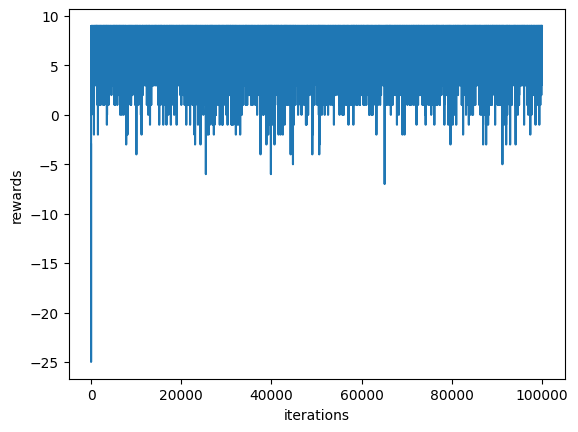

In [63]:
# plot rewards over iterations
import matplotlib.pyplot as plt
plt.plot(game_rew)
plt.ylabel('rewards')
plt.xlabel('iterations')


In [64]:
# use Q to find best path
state = game.reset()
end = False
path = []
while end != True:
    action = np.argmax(max(Q[state]))
    next_state, reward, end, actions = game.move(action)
    path.append(action)
    state = next_state
    game.print()
print("path is : ", path)

.¤..
o.x@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
....
....

.¤x.
o..@
...

KeyboardInterrupt: 